In [1]:
import tifffile as tiff
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt
import cv2
import os

In [2]:
# Path to the folder with the images
imgs_path =  "/fhome/mapsiv/QuironHelico/WSI_Example"
imgs_name = [name for name in os.listdir(imgs_path) if not ".csv" in name]

In [4]:
def preprocess_image(image):
    # apply opening
    kernel = np.ones((5, 5), np.uint8)
    opening = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)

    # add white padding to the image
    # So, we can find the contours of the cells touching the border
    opening = cv2.copyMakeBorder(opening, 10, 10, 10, 10, cv2.BORDER_CONSTANT, value=[255, 255, 255])

    # find the contours
    contours, hierarchy = cv2.findContours(opening, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # find the bounding boxes of the contours
    area_image = image.shape[0] * image.shape[1]
    bounding_boxes = [cv2.boundingRect(c) for c in contours if cv2.contourArea(c) < (area_image*0.5)]
    
    return contours, bounding_boxes

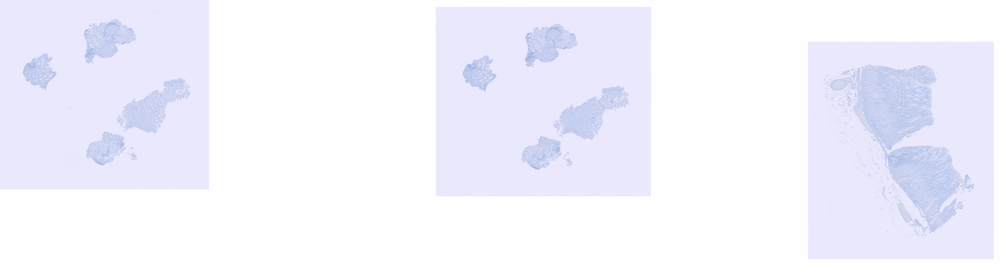

In [11]:
pil_img

Original image size: (125952, 33792)
Resized image size: (12595, 3379)
Found 2 contours


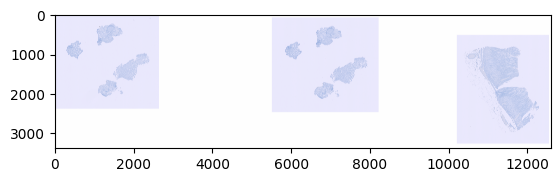

ValueError: operands could not be broadcast together with shapes (14,1,2) (11,1,2) 

In [17]:
# crop the images
def crop_images(image, contours, name):
    image = image.copy()
    for i, c in enumerate(bounding_boxes):
        x, y, w, h = c
        new_img = image[y:y + h, x:x + w]
        cv2.imwrite("{}_{}.png".format(name, i), new_img)

for img_name in imgs_name: 
    img_path = os.path.join(imgs_path, img_name) 
    img = tiff.imread(img_path)
    img_array = np.array(img)
    pil_img = Image.fromarray(img_array)
    print("Original image size:", pil_img.size)
    pil_img.thumbnail((pil_img.size[0]//10, pil_img.size[0]//10))
    print("Resized image size:", pil_img.size)
    open_cv_image = np.array(pil_img)[:, :, ::-1].copy()
    
    gray = cv2.cvtColor(open_cv_image, cv2.COLOR_BGR2GRAY)

    ret, thresh1 = cv2.threshold(gray, 240, 255, cv2.THRESH_BINARY)
    bounding_boxes = preprocess_image(thresh1)
    print("Found {} contours".format(len(bounding_boxes)))

    image = open_cv_image.copy()
    #image = cv2.drawContours(image, bounding_boxes, 1, (0, 255, 0), 3)
    
    plt.imshow(image[:, :, ::-1])
    plt.show()

    crop_images(open_cv_image, bounding_boxes, img_name.split(".")[0])


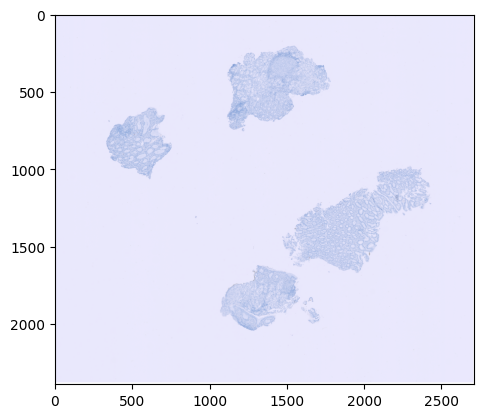

In [5]:
img = cv2.imread('/fhome/gia07/project/Maria/B22-35-HP_1.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)

## Try 1

In [27]:
def preprocess_image(img, open_kernel=(5,5), close_kernel=(3,3)):
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, binary__image = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    
    kernel = np.ones(open_kernel,np.uint8)
    opening = cv2.morphologyEx(binary__image, cv2.MORPH_OPEN, kernel)
    # Do closing
    kernel = np.ones(close_kernel,np.uint8)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)
    return closing

def contours(image, closing):
    area_image = image.shape[0] * image.shape[1]
    img = image.copy()
    # Find countours
    cont, hierarchy = cv2.findContours(closing, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    # If the are is bigger than 90 erase it
    good_contours = []
    for c in cont:
        area = cv2.contourArea(c)
        if (area < (area_image * 0.7)):
            good_contours.append(c)
    return good_contours


## TRY2

In [8]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def preprocess_image(img, open_kernel=(5,5), close_kernel=(3,3)):
    # Apply a threshold to the image
    img_gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    _, binary__image = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)
    
    # Apply opening
    kernel = np.ones(open_kernel,np.uint8)
    opening = cv2.morphologyEx(binary__image, cv2.MORPH_OPEN, kernel)

    # Apply closing
    kernel = np.ones(close_kernel,np.uint8)
    closing = cv2.morphologyEx(opening, cv2.MORPH_CLOSE, kernel)
    return closing

def contours(image, closing):
    area_image = image.shape[0] * image.shape[1]
    img = image.copy()
    # Find countours
    cont, hierarchy = cv2.findContours(closing, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    good_contours = []
    # Get the conturs that are not more than 70% of the image,
    # save and plot them
    for c in cont:
        area = cv2.contourArea(c)
        if (area < (area_image * 0.7)):
            good_contours.append(c)
            cv2.drawContours(img, [c], -1, (0, 255, 0), 1)
    return good_contours

## Visualization

In [7]:
def filter_contours(big_contours, small_contours, approach="corners_bbox"):
    # check if for each small contour if it is inside a big contour
    filtered_contours = []
    # Iterate over the small contours
    for small_contour in small_contours:
        if approach == "corners_bbox":
            # Get the bounding box arround the small contour
            bb = cv2.boundingRect(small_contour)
            x, y, w, h = bb
            points = [(x, y), (x+w, y), (x, y+h), (x+w, y+h)]
        else:
            raise ValueError(f"approach must be corners_bbox. Got {approach} which is not implemented")

        # Iterate over the big contours
        for big_contour in big_contours:
            # Check if each corner of the BB is inside the big contour
            for point in points:
                # If one of the points is not inside the big contour, stop
                if cv2.pointPolygonTest(big_contour, point, False) == -1:
                    break
            else:
                filtered_contours.append(small_contour)
    return filtered_contours


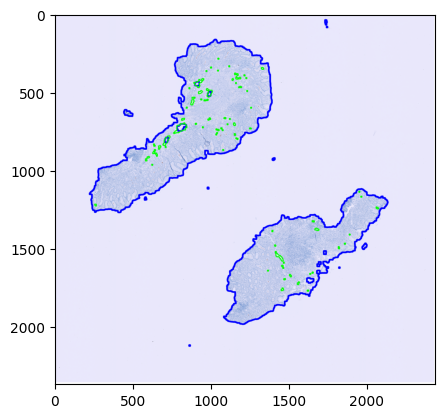

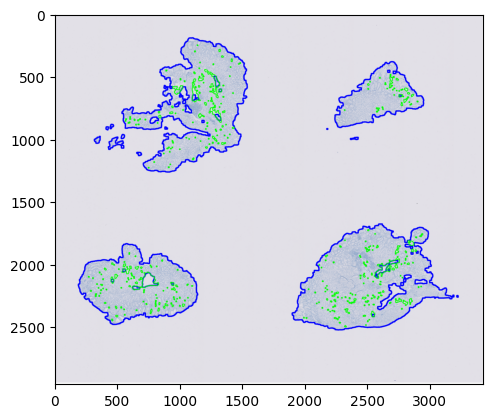

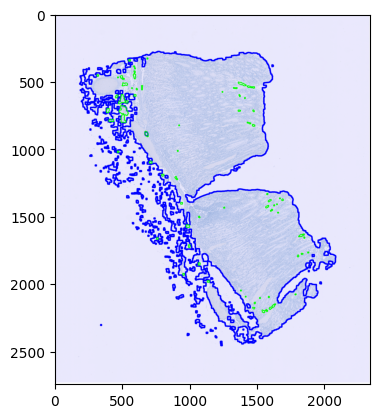

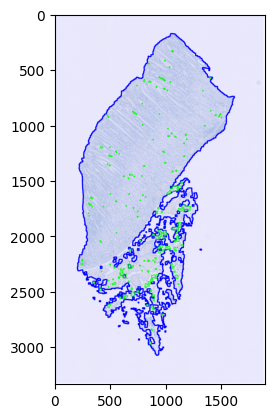

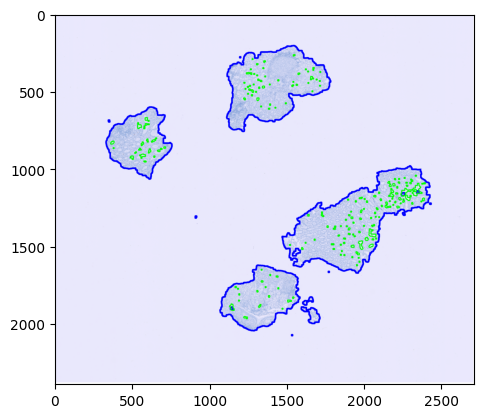

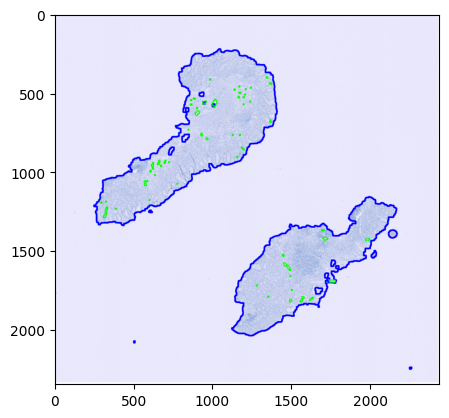

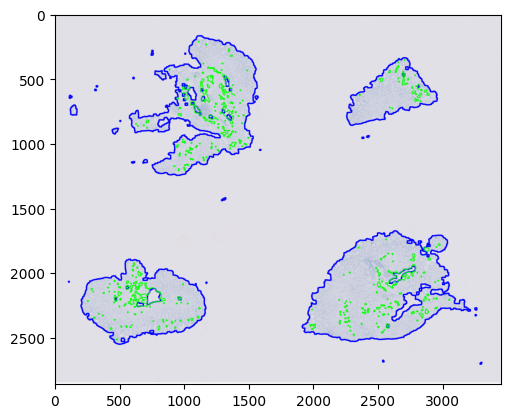

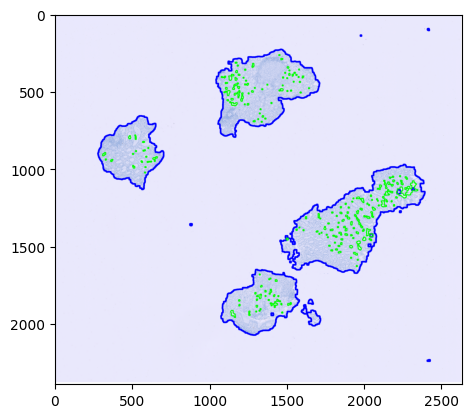

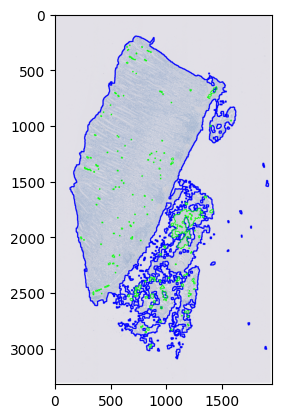

In [45]:
for img in os.listdir('/fhome/gia07/project/Maria'):
    if img.endswith(".ipynb"):
        continue
    # Open the image, it is one of the extracted from the bigger ones
    img = cv2.imread('/fhome/gia07/project/Maria/{}'.format(img))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Preprocess the image with parameters that smooth more the image to find 
    # the contours arround the big parts of the image
    big_blobs = preprocess_image(img, open_kernel=(15, 15), close_kernel=(5, 5))
    big_countours = contours(img, big_blobs)

    # Preprocess the image with parameters that smooth less the image to find
    # the contours arround smaller parts in the image inside the big contours
    small_blobs = preprocess_image(img, open_kernel=(7, 7), close_kernel=(11, 11))
    small_countours = contours(img, small_blobs)
    small_contours = filter_contours(big_countours, small_countours)

    # Draw all the contours on the image
    image = img.copy()
    image = cv2.drawContours(image, big_countours, -1, (0, 0, 255), 10)
    image = cv2.drawContours(image, small_contours, -1, (0, 255, 0), 5)

    plt.imshow(image)
    plt.show()
    # break
    

### Croping patches in the countour

In [19]:
def create_patch(img, point, patch_size):
    # Remove extra dimensions
    while len(point) < 2:
        point = point.squeeze()
    # Get the coordinates of the top left corner
    x, y = point[0]-(patch_size/2), point[1]-(patch_size/2)
    # Crop the patch
    patch = img[int(x):int(x+patch_size), int(y):int(y+patch_size)]
    # To plot the square of the patch in the image
    # cv2.rectangle(img, (int(x), int(y)), (int(x+patch_size), int(y+patch_size)), (0, 255, 0), 2)
    return patch

def get_patches_contour(img, contours, patch_size):
    patches = []
    # For each contour found in the image
    for contour in contours:
        distance = 0
        patch_generated = False
        # For each point in the contour
        for i in range(1, contour.shape[0]):
            # add to the distance the distance between the current point and the previous one
            distance += (np.linalg.norm(contour[i-1] - contour[i]))

            # If the distance is bigger than the patch size, generate a patch
            # It has overlap between patches as the distance is over the contour
            # not a straight line to the last patch
            if distance > patch_size:
                patch = create_patch(img, contour[i-1:i], patch_size)
                # If the patch has the correct size, add it to the list of patches
                # If not, it means that the countour was near the border of the image
                # So, we ignore this point and we will try with the next one
                if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                    patches.append(patch)
                    distance = 0
                    patch_generated = True

        # If the contour is smaller than the patch size, generate a patch at the center
        if not patch_generated:
            center = np.mean(contour, axis=0)
            patch = create_patch(img, center, patch_size)
            if patch.shape[0] == patch_size and patch.shape[1] == patch_size:
                patches.append(patch)
    return patches

25
114


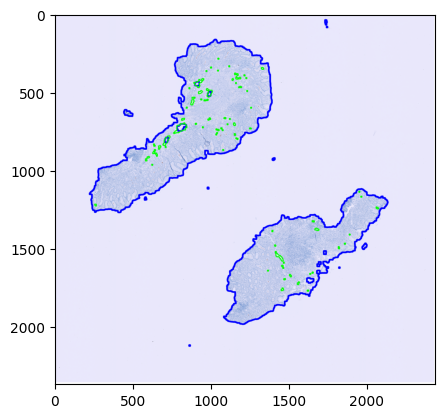

In [20]:
import os
import cv2
size_of_patch = 256

for img in os.listdir('/fhome/gia07/project/Maria'):
    if img.endswith(".ipynb"):
        continue
    patches = []
    # Open the image, it is one of the extracted from the bigger ones
    img = cv2.imread('/fhome/gia07/project/Maria/{}'.format(img))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Preprocess the image with parameters that smooth more the image to find 
    # the contours arround the big parts of the image
    big_blobs = preprocess_image(img, open_kernel=(15, 15), close_kernel=(5, 5))
    big_countours = contours(img, big_blobs)

    # Get the patches from the contours
    patches.extend(get_patches_contour(img, big_countours, size_of_patch))
    print(len(patches))

    # Preprocess the image with parameters that smooth less the image to find
    # the contours arround smaller parts in the image inside the big contours
    small_blobs = preprocess_image(img, open_kernel=(7, 7), close_kernel=(11, 11))
    small_countours = contours(img, small_blobs)
    # Keep the contours that are inside the big contours
    small_contours = filter_contours(big_countours, small_countours)

    # Save the patches from the small contours
    patches.extend(get_patches_contour(img, small_countours, size_of_patch))
    print(len(patches))

    # Draw all the contours on the image
    image = img.copy()
    image = cv2.drawContours(image, big_countours, -1, (0, 0, 255), 10)
    image = cv2.drawContours(image, small_contours, -1, (0, 255, 0), 5)

    plt.imshow(image)
    plt.show()
    break

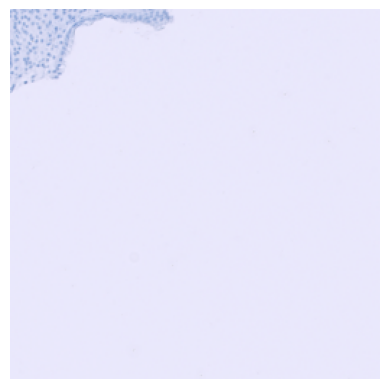

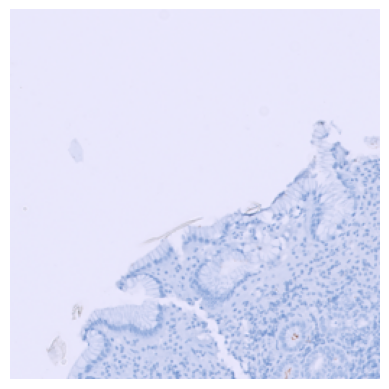

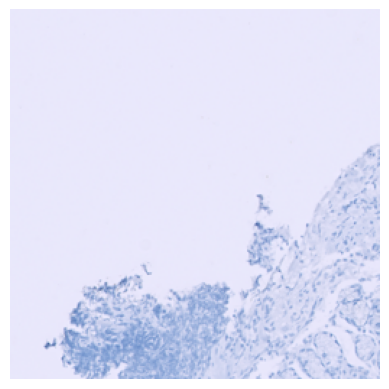

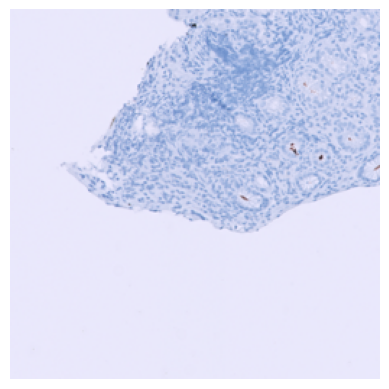

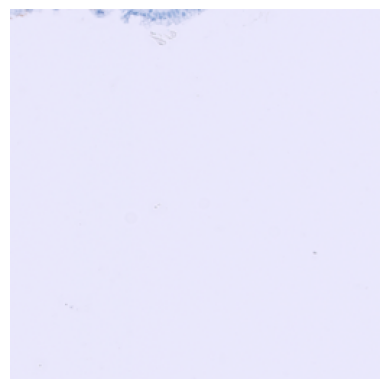

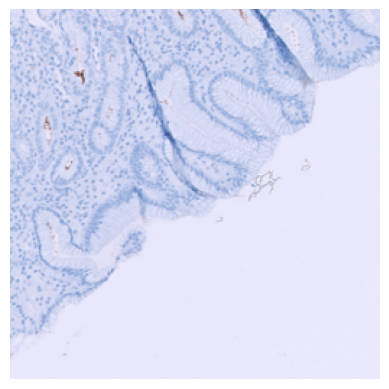

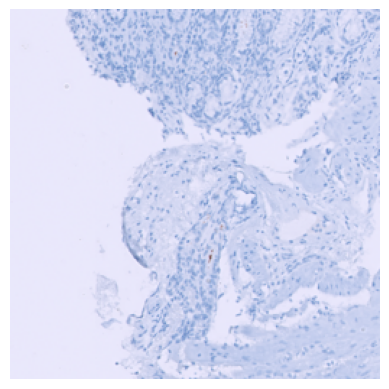

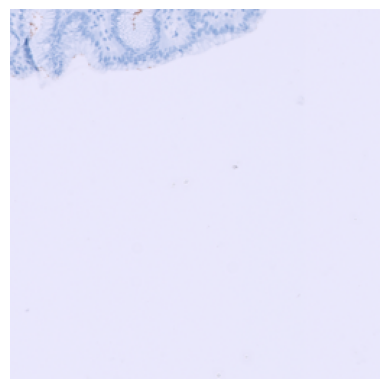

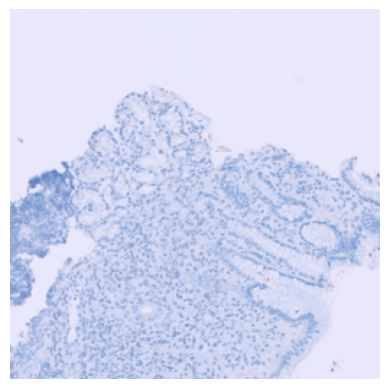

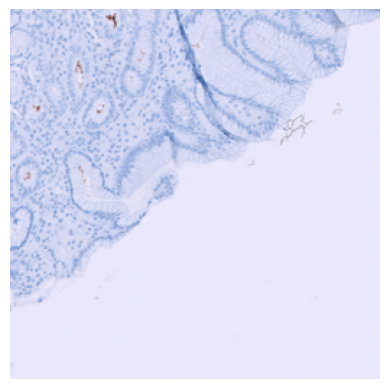

In [21]:
# Show 10 random patches from the previous image
for i in range(10):
    idx = np.random.randint(0, len(patches))
    plt.imshow(patches[idx])
    plt.axis('off')
    plt.show()